## Описание проекта

Подготовьте прототип модели машинного обучения для «Цифры». Компания разрабатывает решения для эффективной работы промышленных предприятий.

Модель должна предсказать коэффициент восстановления золота из золотосодержащей руды. Используйте данные с параметрами добычи и очистки. 

Модель поможет оптимизировать производство, чтобы не запускать предприятие с убыточными характеристиками.

## Подготовка данных

Импорт библиотек

In [1]:
import pandas as pd
from collections import defaultdict
%pip install sweetviz
import sweetviz as sv
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns
from sklearn.metrics import mean_absolute_error
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import fbeta_score, make_scorer
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.dummy import DummyRegressor
from sklearn.model_selection import GridSearchCV

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.1/15.1 MB 9.6 MB/s eta 0:00:00:00:0100:01
Note: you may need to restart the kernel to use updated packages.


### Чтение файлов и предварительный анализ

In [2]:
train = pd.read_csv('train.csv')
test = pd.read_csv('test.csv')
full = pd.read_csv('full.csv')

                                             |      | [  0%]   00:00 -> (? left)


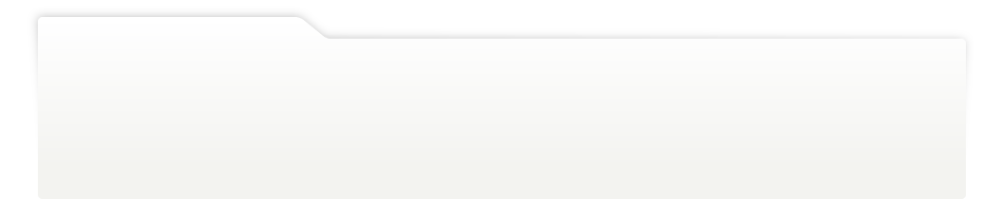
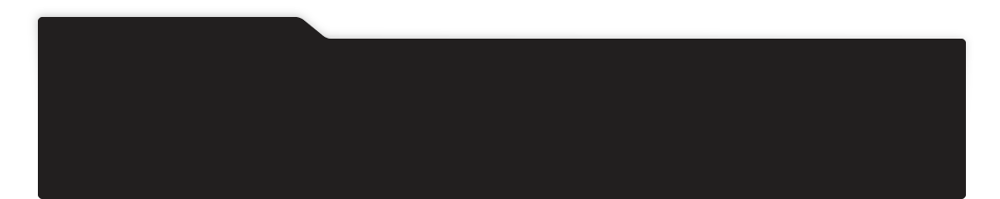
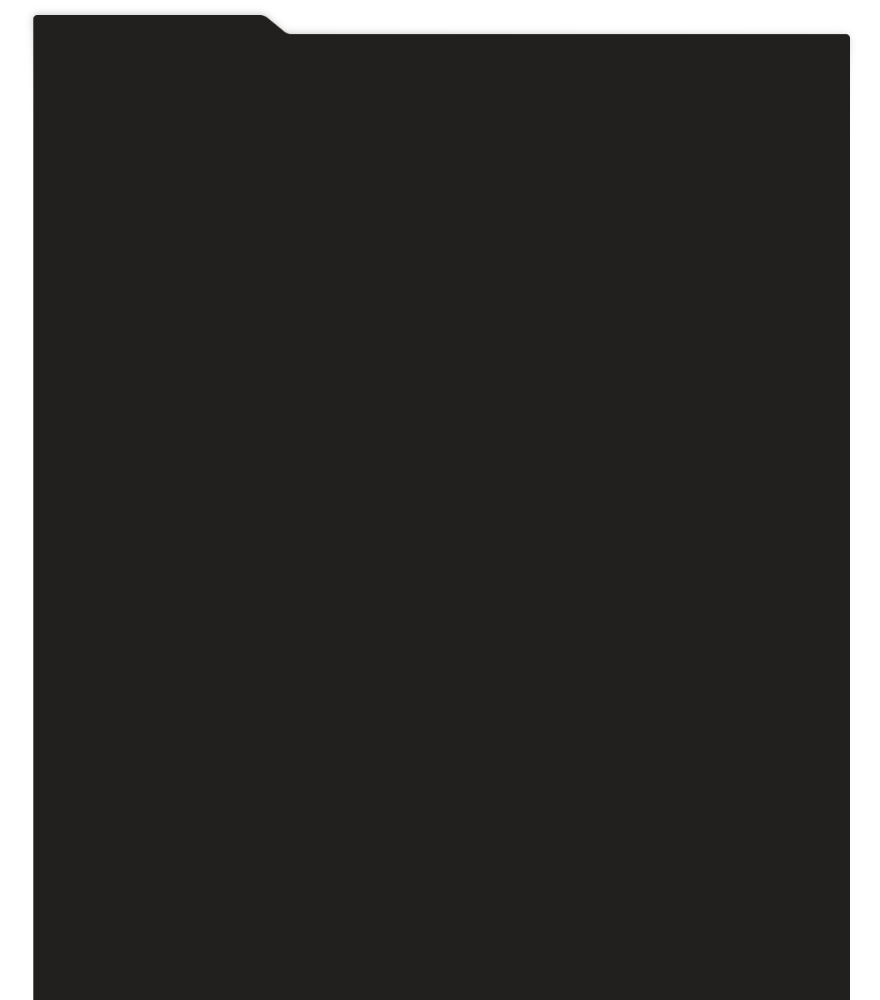
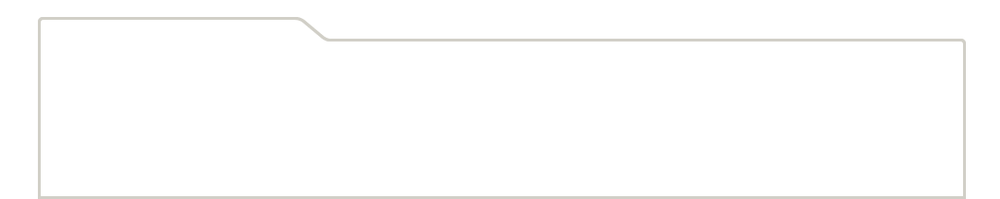
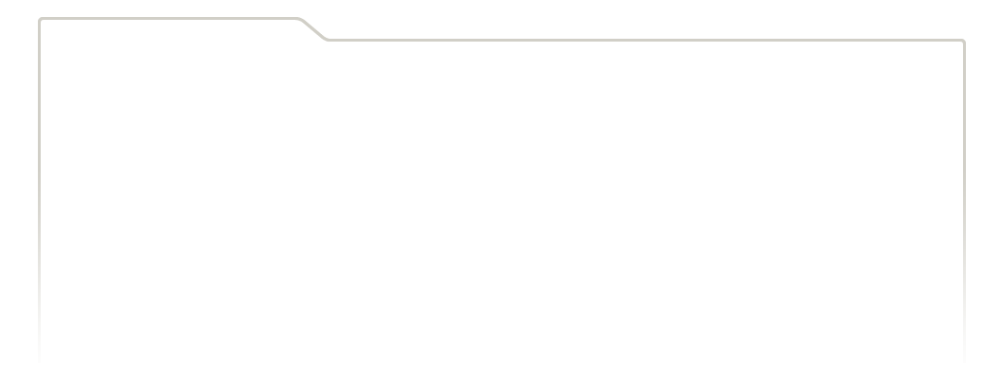
...
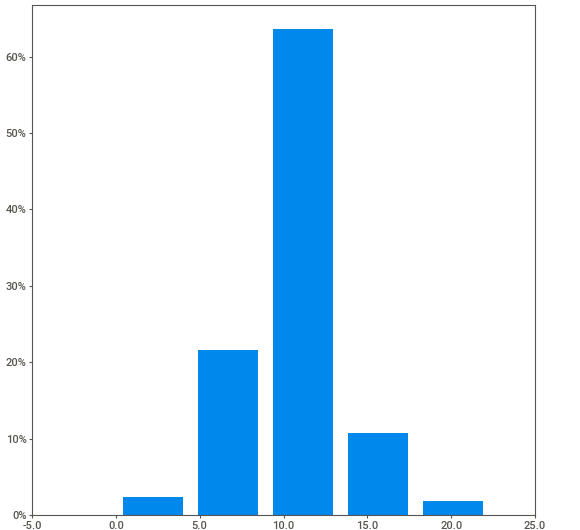
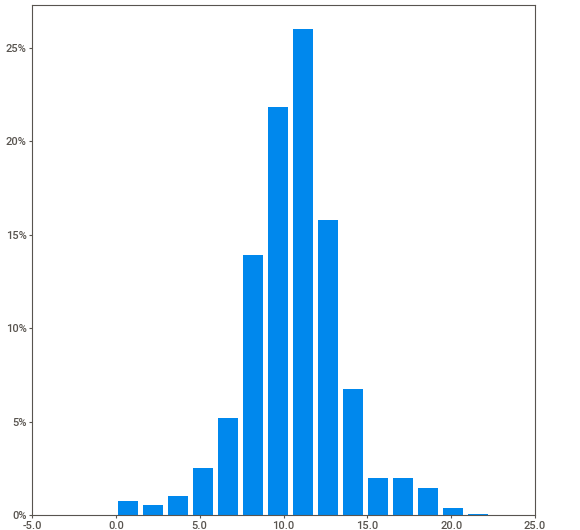
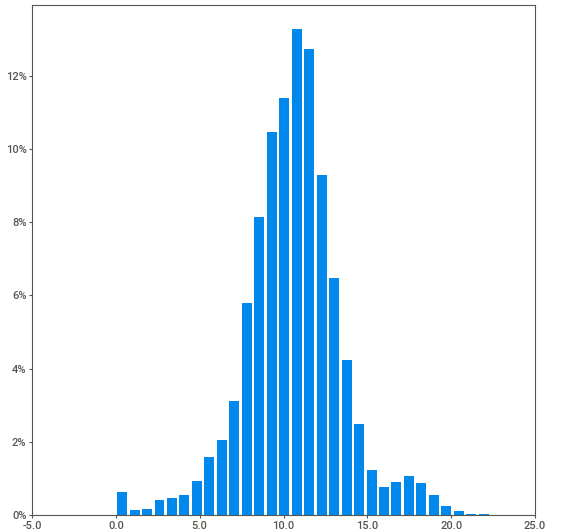
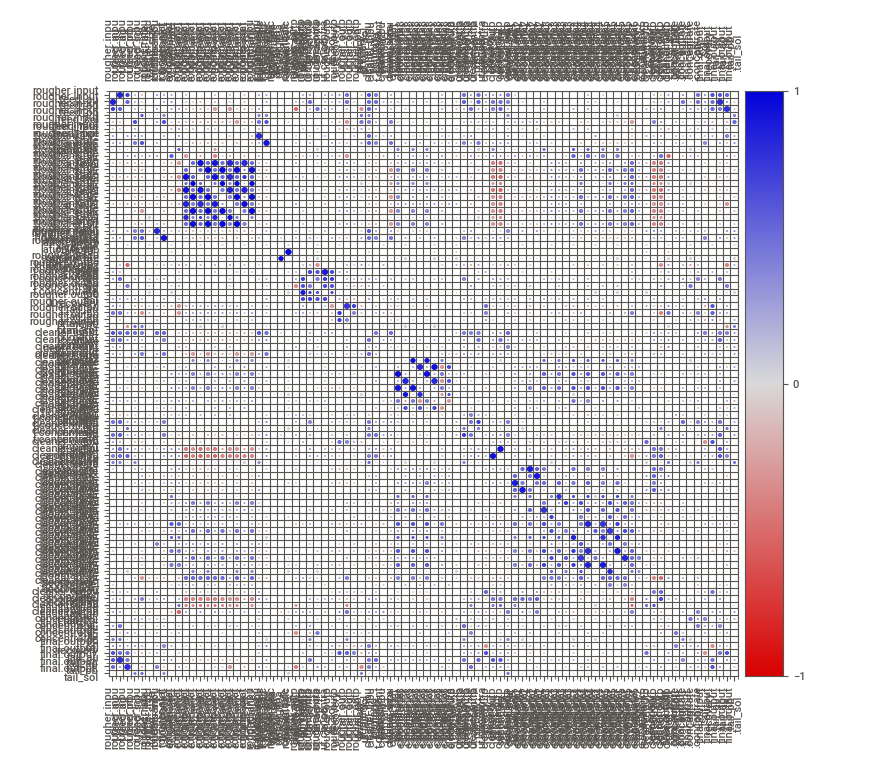
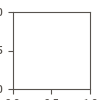

In [3]:
train_report = sv.analyze(train)
train_report.show_notebook()

                                             |      | [  0%]   00:00 -> (? left)


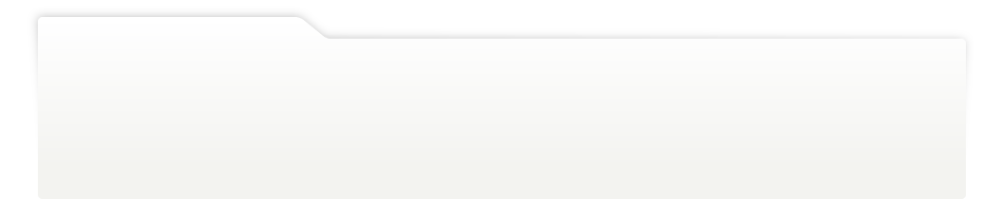
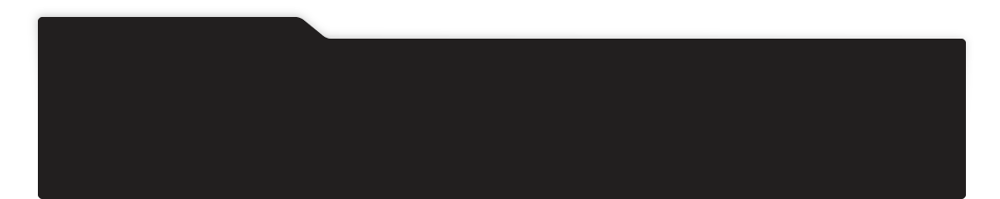
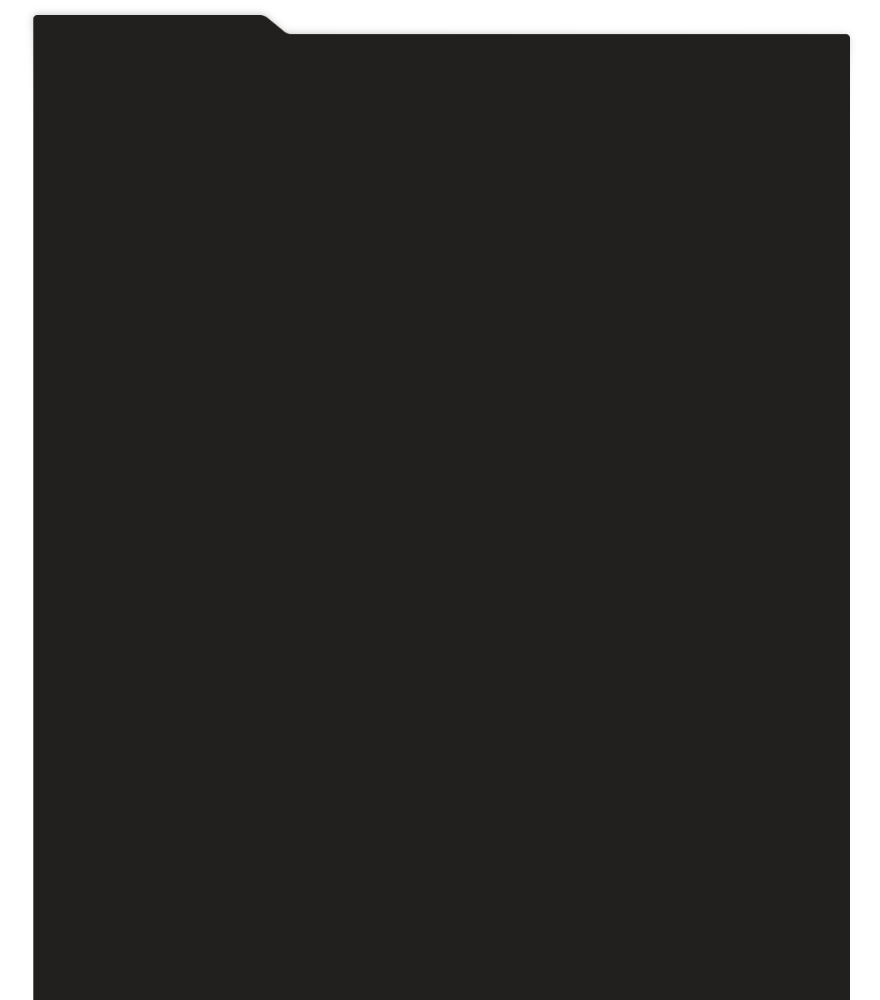
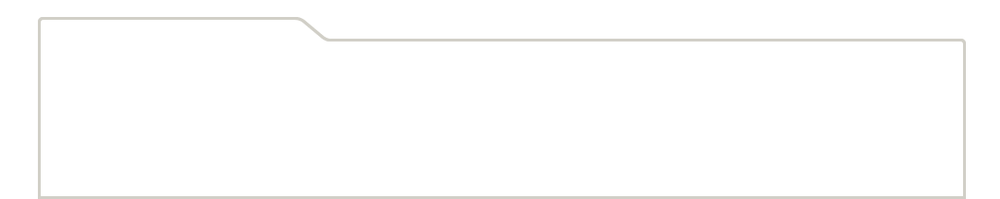
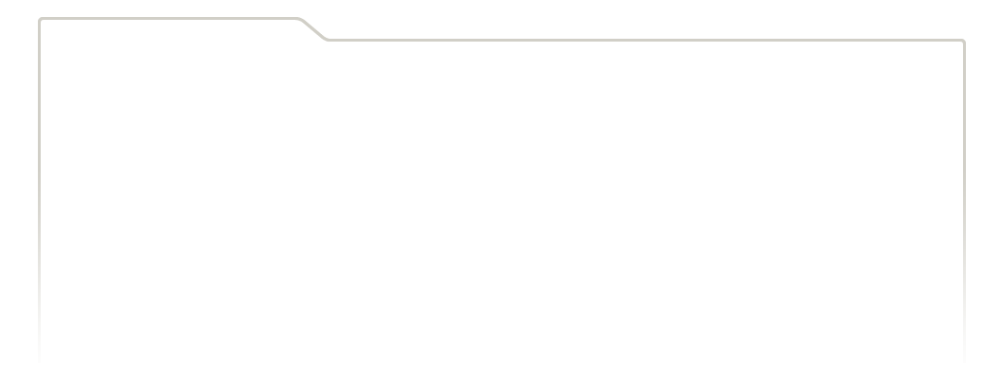
...
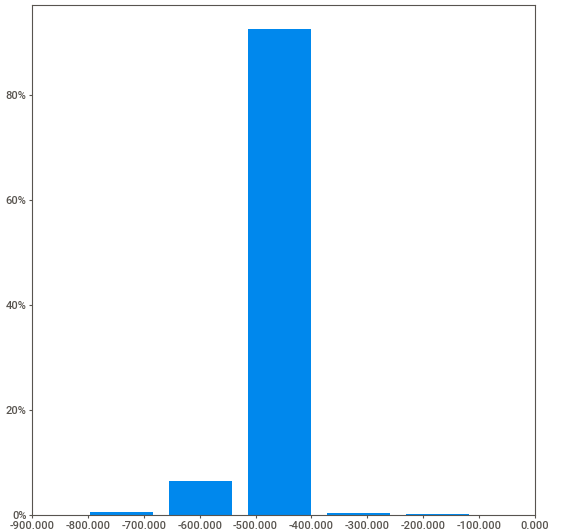
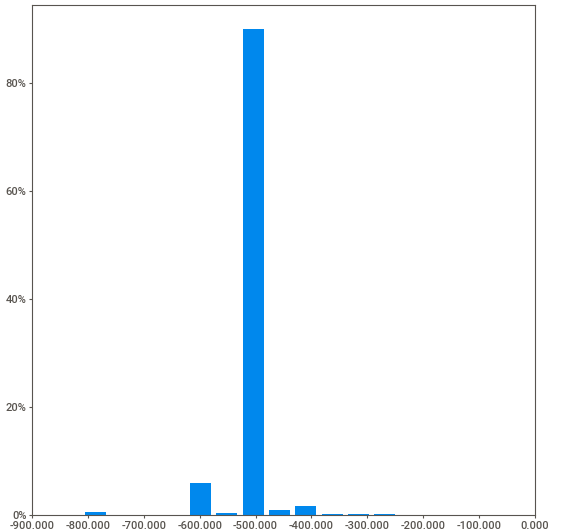
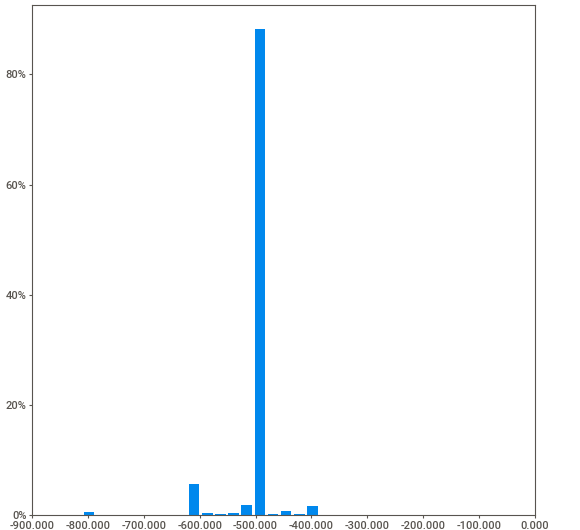
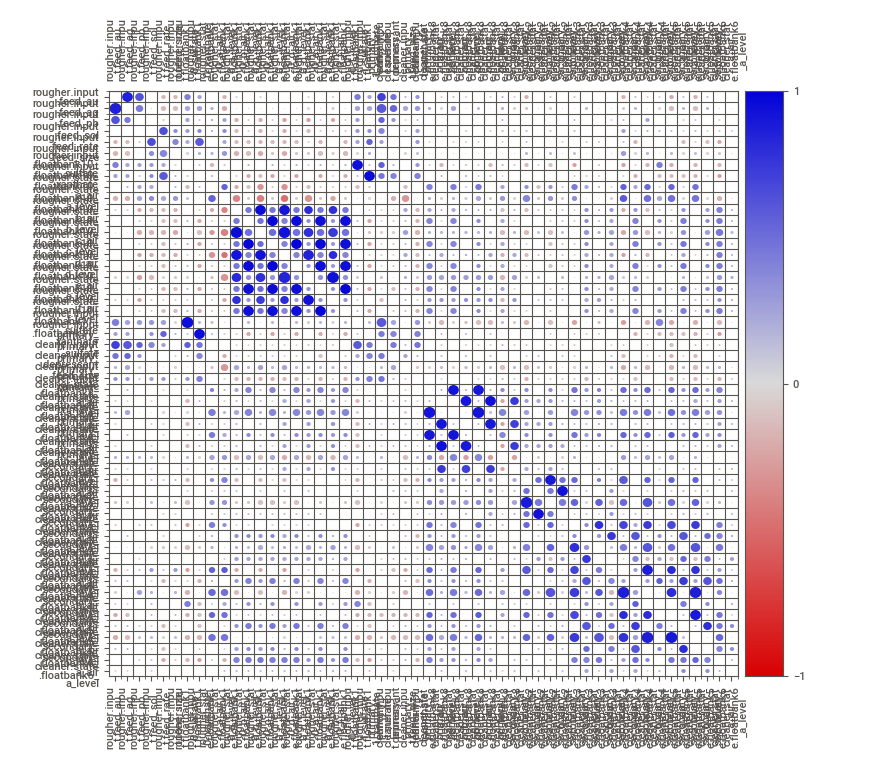
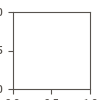

In [4]:
test_report = sv.analyze(test)
test_report.show_notebook()

                                             |      | [  0%]   00:00 -> (? left)


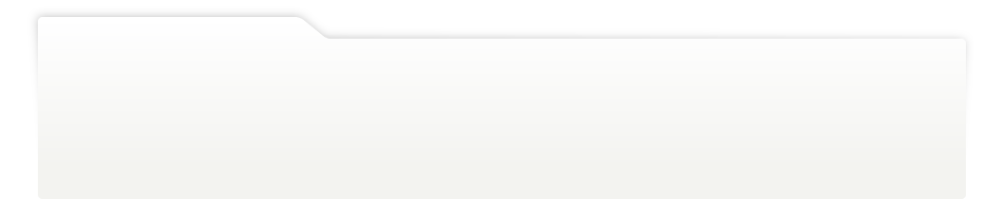
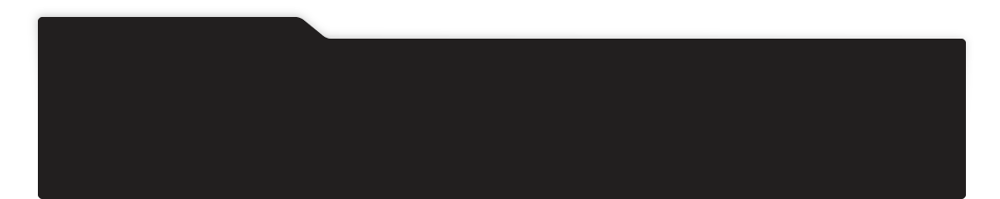
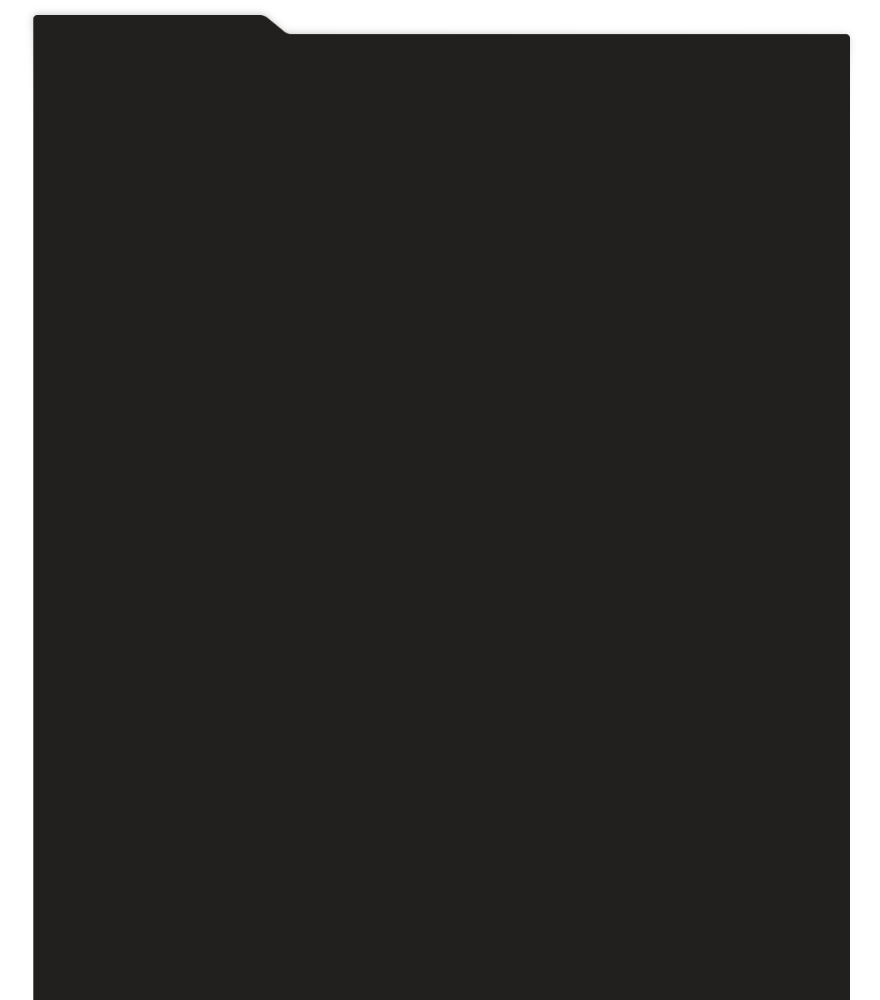
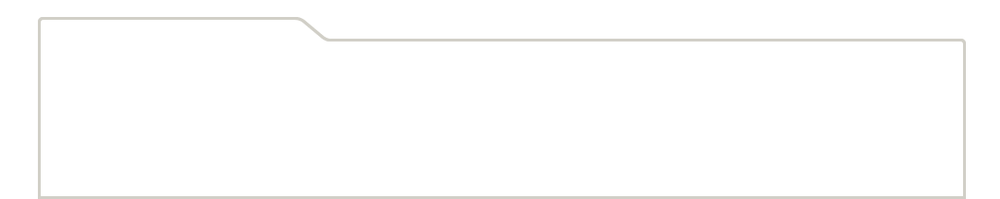
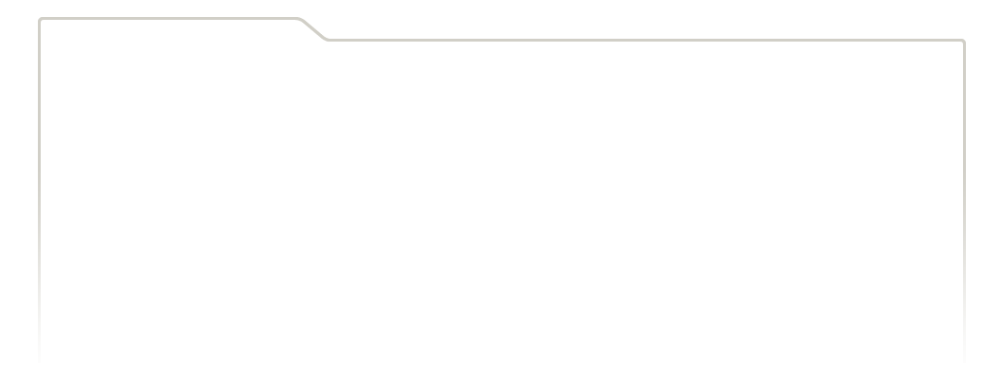
...
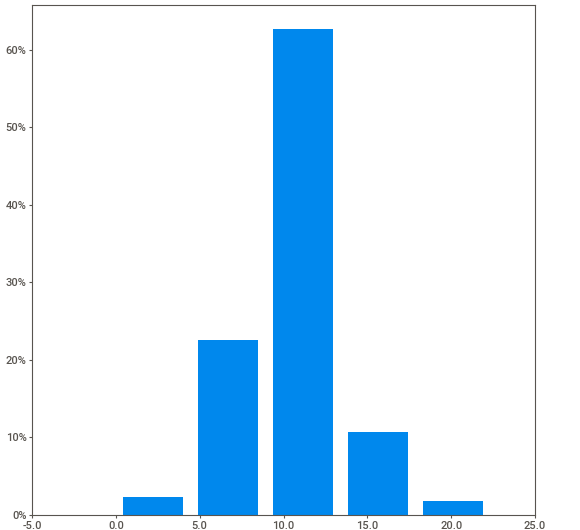
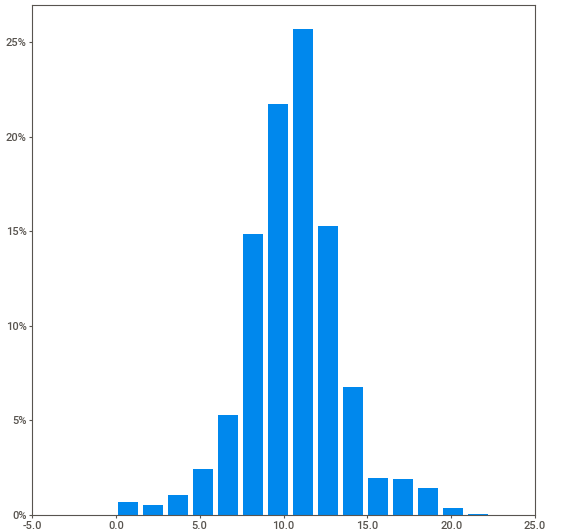
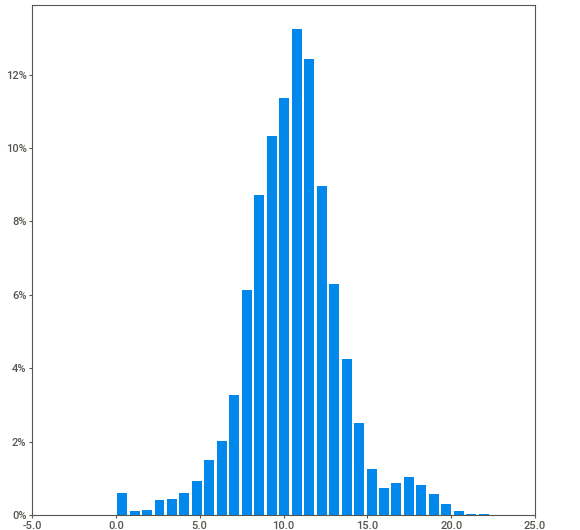
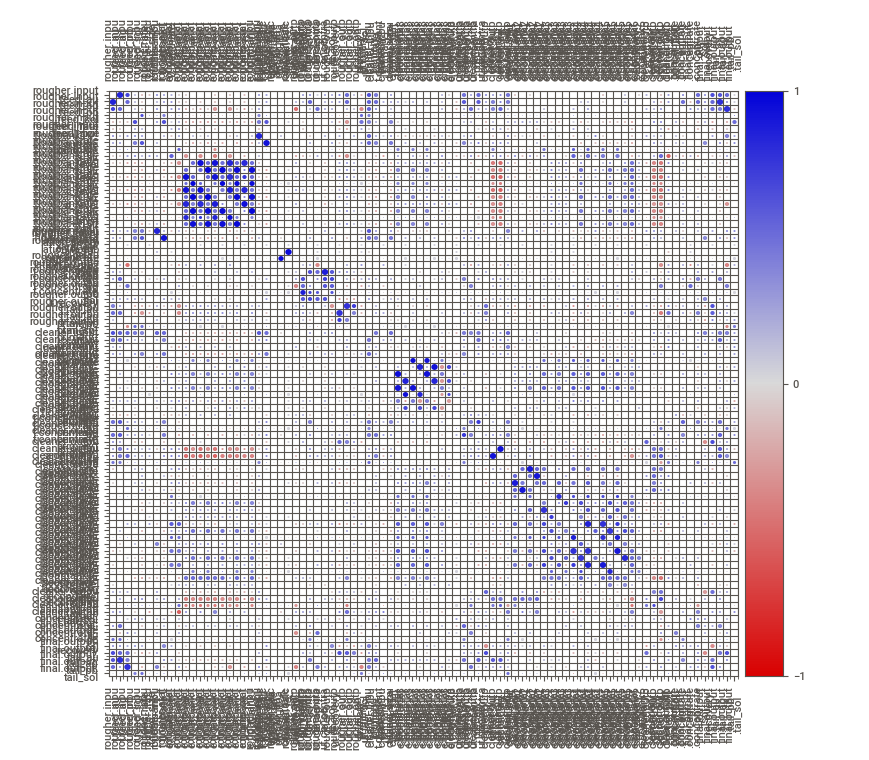
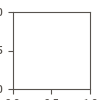

In [5]:
full_report = sv.analyze(full)
full_report.show_notebook()

### Проверим, что эффективность обогащения рассчитана верно

Вычислим эффективность обогащения на обучающей выборке.

In [6]:
C = train['rougher.output.concentrate_au']
F = train['rougher.input.feed_au']
T = train['rougher.output.tail_au']

Создадим новый столбец для наших вычислений.

In [7]:
train['recovery_new'] = ((C*(F-T))/(F*(C-T)))*100
train['recovery_new'].mean()

82.52119968211305

Сравним с прзнаком rougher.output.recovery.

In [8]:
train['rougher.output.recovery'].mean()

82.52119968211304

Найдем среднюю абсолютную ошибку (MAE) между нашими расчётами и значением признака.

In [9]:
print(mean_absolute_error(train['recovery_new'], train['rougher.output.recovery']))

9.83758577644259e-15


Значение MAE низкое, что подтверждает тот факт что эффективность обогащения рассчитана правильно.

Теперь столбец можно удалить.

In [10]:
train.drop('recovery_new', axis=1, inplace=True)

### Проанализируем признаки, недоступные в тестовой выборке. 

In [11]:
set(train.columns)-set(test.columns) 

{'final.output.concentrate_ag',
 'final.output.concentrate_au',
 'final.output.concentrate_pb',
 'final.output.concentrate_sol',
 'final.output.recovery',
 'final.output.tail_ag',
 'final.output.tail_au',
 'final.output.tail_pb',
 'final.output.tail_sol',
 'primary_cleaner.output.concentrate_ag',
 'primary_cleaner.output.concentrate_au',
 'primary_cleaner.output.concentrate_pb',
 'primary_cleaner.output.concentrate_sol',
 'primary_cleaner.output.tail_ag',
 'primary_cleaner.output.tail_au',
 'primary_cleaner.output.tail_pb',
 'primary_cleaner.output.tail_sol',
 'rougher.calculation.au_pb_ratio',
 'rougher.calculation.floatbank10_sulfate_to_au_feed',
 'rougher.calculation.floatbank11_sulfate_to_au_feed',
 'rougher.calculation.sulfate_to_au_concentrate',
 'rougher.output.concentrate_ag',
 'rougher.output.concentrate_au',
 'rougher.output.concentrate_pb',
 'rougher.output.concentrate_sol',
 'rougher.output.recovery',
 'rougher.output.tail_ag',
 'rougher.output.tail_au',
 'rougher.output.ta

Здесь присутствуют признаки, относясящиеся к вторичным стадиям обогащения, параметры продуктов, расчетные характеристики, относящиеся к разным этапам.

### Предобработка данных.

Данные индексируются датой и временем получения информации (признак date). Соседние по времени параметры часто похожи, поэтому заменим пропуски значениями предыдущих строк.

In [15]:
datasets = [train, test, full]
for i in datasets:
    i.fillna(method='ffill', inplace=True)

Проверим данные на дубликаты.

In [16]:
for i in datasets:
    print('Количество дубликатов:', i.duplicated().sum())

Количество дубликатов: 0
Количество дубликатов: 0
Количество дубликатов: 0


## Анализ данных

### Посмотрим, как меняется концентрация металлов (Au, Ag, Pb) на различных этапах очистки.

Отфильтруем даные для серебра.

In [17]:
df_ag = full[['rougher.input.feed_ag', 
              'rougher.output.concentrate_ag', 
              'primary_cleaner.output.concentrate_ag', 
              'final.output.concentrate_ag']]

Переименуем столбцы.

In [18]:
df_ag = df_ag.rename(columns={'rougher.input.feed_ag': 'Исходное сырье', 
                              'rougher.output.concentrate_ag': 'Флотация серебра', 
                              'primary_cleaner.output.concentrate_ag': 'Первичная очистка серебра', 
                              'final.output.concentrate_ag': 'Финальная очистка серебра'})

Отфильтруем даные для свинца.

In [19]:
df_pb = full[['rougher.input.feed_pb', 
              'rougher.output.concentrate_pb', 
              'primary_cleaner.output.concentrate_pb', 
              'final.output.concentrate_pb']]

Переименуем столбцы.

In [20]:
df_pb = df_pb.rename(columns={'rougher.input.feed_pb': 'Исходное сырье', 
                              'rougher.output.concentrate_pb': 'Флотация свинца', 
                              'primary_cleaner.output.concentrate_pb': 'Первичная очистка свинца', 
                              'final.output.concentrate_pb': 'Финальная очистка свинца'})

Отфильтруем даные для золота.

In [21]:
df_au = full[['rougher.input.feed_au', 
              'rougher.output.concentrate_au', 
              'primary_cleaner.output.concentrate_au', 
              'final.output.concentrate_au']]

Переименуем столбцы.

In [22]:
df_au = df_au.rename(columns={'rougher.input.feed_au': 'Исходное сырье', 
                              'rougher.output.concentrate_au': 'Флотация золота', 
                              'primary_cleaner.output.concentrate_au': 'Первичная очистка золота', 
                              'final.output.concentrate_au': 'Финальная очистка золота'})

Теперь данные можно визуализировать каждый этап по отдельности.

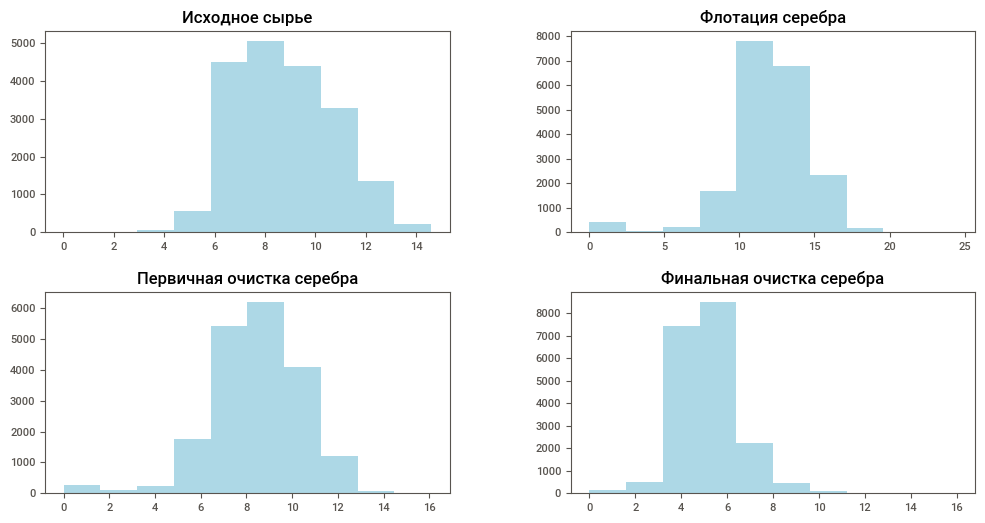

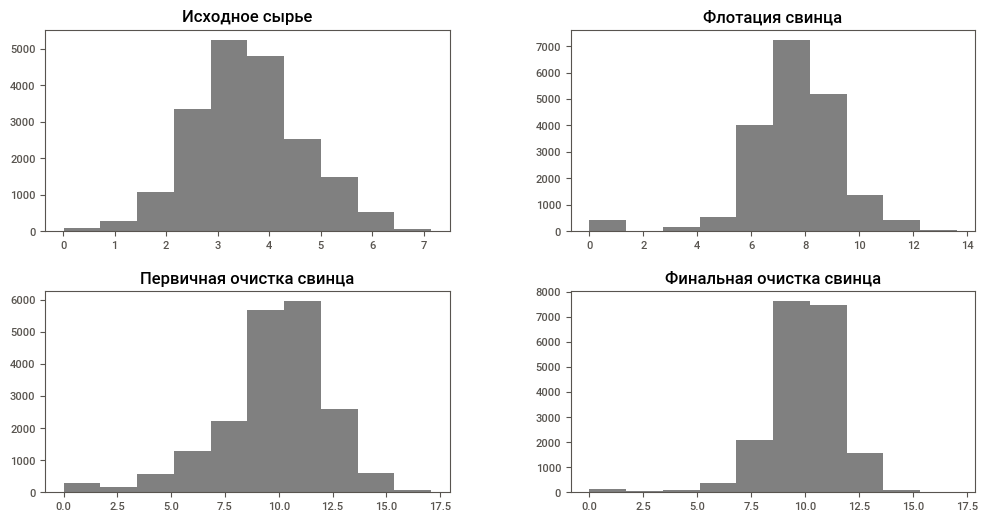

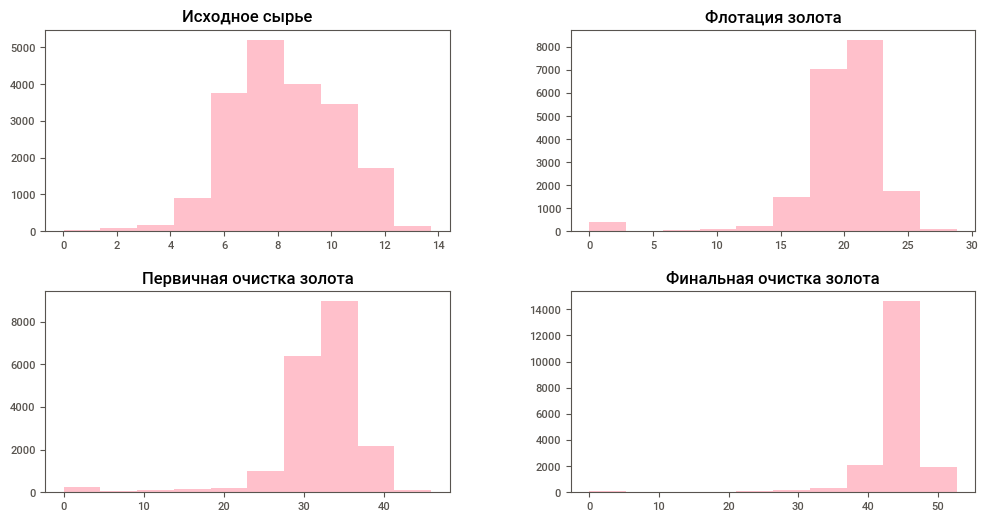

In [23]:
df_ag.hist(grid=False, figsize=(12,6), color='lightblue')
df_pb.hist(grid=False, figsize=(12,6), color='gray')
df_au.hist(grid=False, figsize=(12,6), color='pink')
plt.show()

А так же можно посмотреть общую картинку.

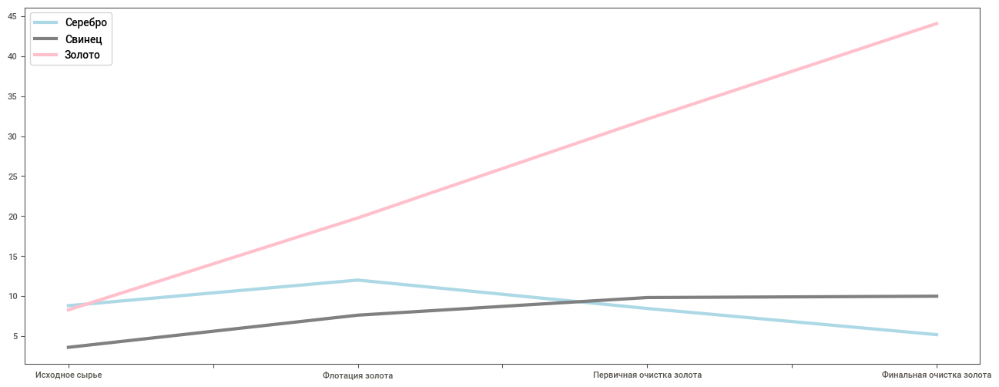

In [24]:
plt.figure(figsize=(16, 6))
df_ag.mean().plot(color='lightblue', label='Серебро', linewidth=3)
df_pb.mean().plot(color='gray', label='Свинец', linewidth=3)
df_au.mean().plot(color='pink', label='Золото', linewidth=3)
plt.legend()
plt.show()

**Вывод:**  
Концентрация серебра равномерно уменьшается в процессе очистки.  
Концентрация свинца повышается от стадии флотации к первичной очистке, а потом повышается медленнее на стадии финальной очистки.  
Концентрация золота равномерно повышается от флотации до финальной очистки.  

### Сравним распределения размеров гранул сырья на обучающей и тестовой выборках.

Визуализируем распределения размеров.

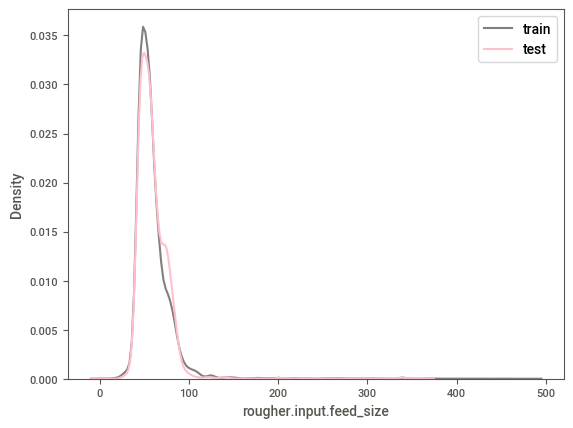

In [25]:
sns.kdeplot(train['rougher.input.feed_size'], label='train', color='gray')
sns.kdeplot(test['rougher.input.feed_size'], label='test', color='pink')
plt.legend()

**Вывод:**  
Распределения размеров гранул сырья на обучающей и тестовой выборках аналогичны. 

### Исследуем суммарную концентрацию всех веществ на разных стадиях: в сырье, в черновом и финальном концентратах. 

Найдем суммарную концентрацию веществ в сырье. 

In [26]:
conc_feed = full[['rougher.input.feed_ag', 
                   'rougher.input.feed_pb', 
                   'rougher.input.feed_sol', 
                   'rougher.input.feed_au']].sum(axis=1)

Визуализируем данные.

Text(0.5, 1.0, 'Суммарная концентрация веществ в сырье')

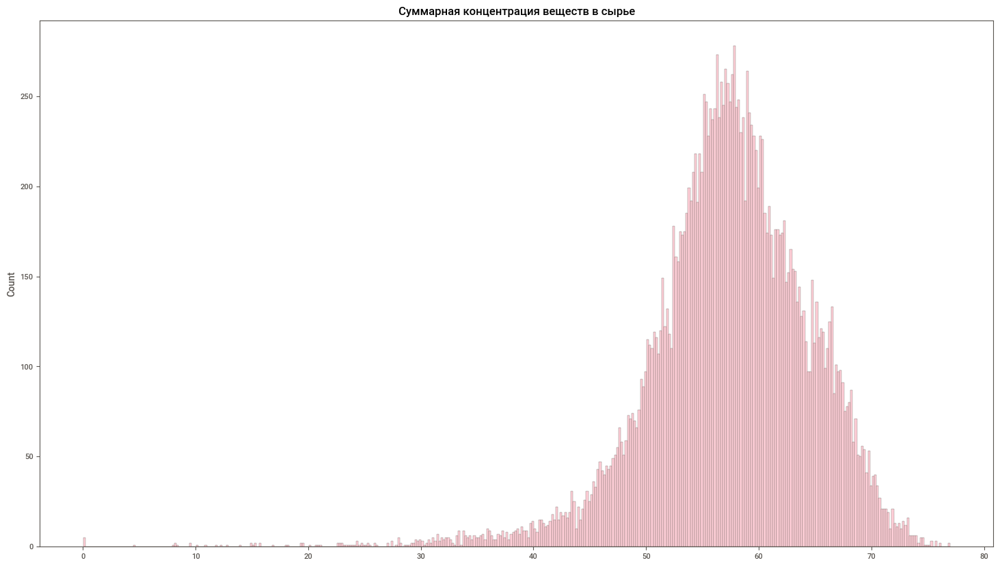

In [27]:
plt.subplots(figsize = (18,10))
sns.histplot(conc_feed, bins=400, color='pink')
plt.title('Суммарная концентрация веществ в сырье')

Найдем суммарную концентрацию веществ в черновом концентрате и визуализируем данные.

In [28]:
conc_rougher = full[['rougher.output.concentrate_pb', 
                   'rougher.output.concentrate_ag', 
                   'rougher.output.concentrate_sol', 
                   'rougher.output.concentrate_au']].sum(axis=1)

Text(0.5, 1.0, 'Суммарная концентрация веществ в черновом концентрате')

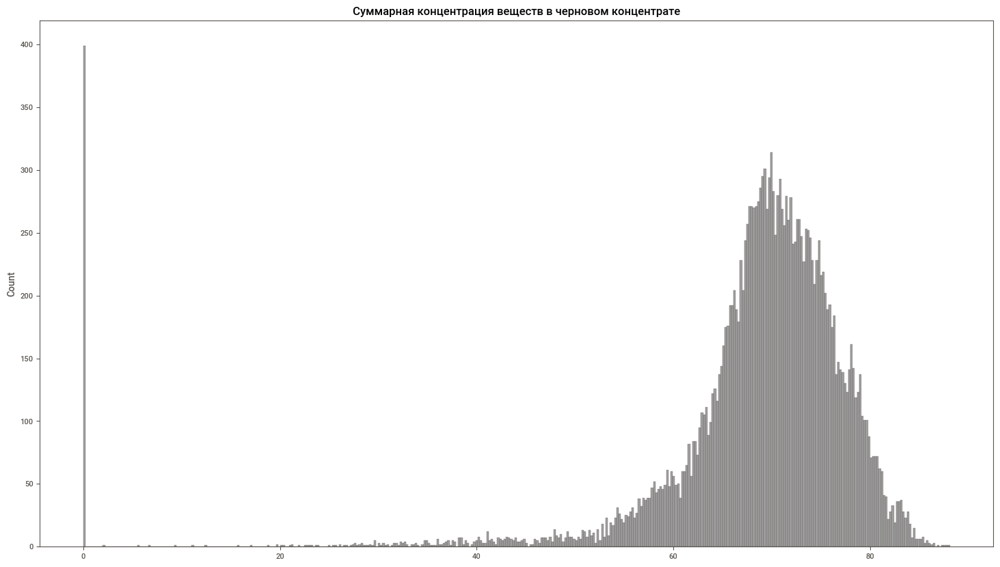

In [29]:
plt.subplots(figsize = (18,10))
sns.histplot(conc_rougher, bins=400, color='gray')
plt.title('Суммарная концентрация веществ в черновом концентрате')

Найдем суммарную концентрацию веществ в финальном концентрате и визуализируем данные.

In [30]:
conc_final = full[['final.output.concentrate_pb', 
                   'final.output.concentrate_ag', 
                   'final.output.concentrate_sol', 
                   'final.output.concentrate_au']].sum(axis=1)

Text(0.5, 1.0, 'Суммарная концентрация веществ в финальном концентрате')

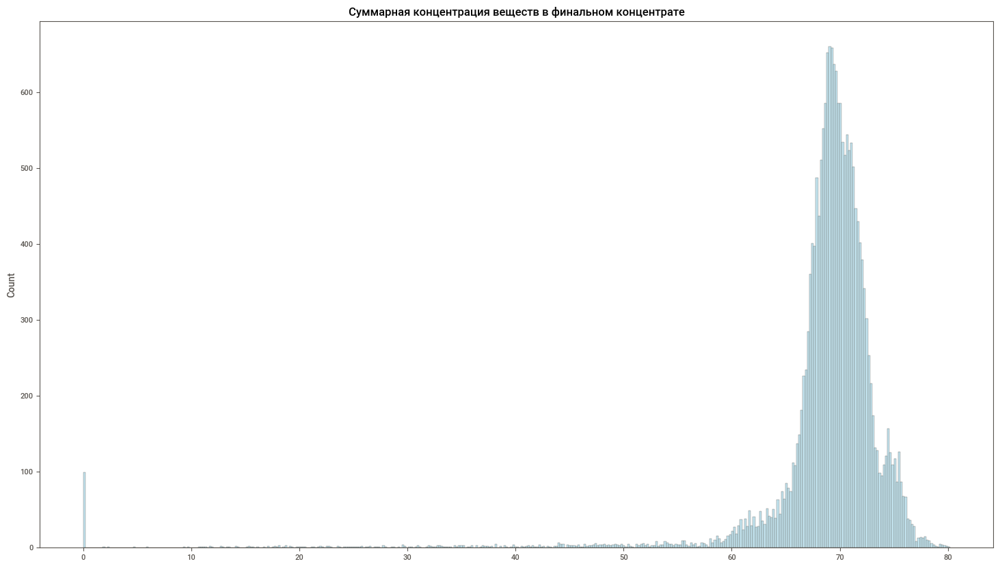

In [31]:
plt.subplots(figsize = (18,10))
sns.histplot(conc_final, bins=400, color='lightblue')
plt.title('Суммарная концентрация веществ в финальном концентрате')

В данных присутствуют нулевые выбросы, что странно, потому что это сумма. Считаю, что от этих выбросов лучше избавиться.

In [32]:
index_final = np.array(conc_final[conc_final==0].index, dtype=object)
index_rougher = np.array(conc_rougher[conc_rougher==0].index, dtype=object)
index_final = np.concatenate([index_rougher, index_final])
full = full.drop(labels=index_final, axis=0)

Суммарная концентрация всех веществ на стадиях уменьшается, но ближе к финальной стадии возрастает.

## Модель

### Составление функции sMAPE.

Составим функцию для вычисления итоговой sMAPE.

In [33]:
def smape(target, predicted):
    return (((abs(target - predicted) * 2 * 100) /
              (abs(target) + abs(predicted))).sum()) / len(target)
def smape_final(rougher, final):
    return 0.25*rougher.item() + 0.75*final.item()

### Выделение признаков на выборках.

Создадим датасет для целевых признаков, недостающих в тестовой выборке и добавим эти признаки в тестовую выборку из полной.

In [34]:
df_target = full[['date', 'rougher.output.recovery', 'final.output.recovery']]
test = test.merge(df_target, how = 'left', on = 'date')

Удалим столбец с датой за ненадобностью.

In [35]:
test.drop(['date'], axis=1, inplace=True)

Удалим из тренировочной выборки те признаки, которых нет в тестовой.

In [36]:
train = train.drop(set(train.columns)-set(test.columns), axis=1)

Выделим признаки на тренировочной выборке для чернового концентрата.

In [37]:
features_train_rougher = train.filter(regex='^rougher',axis=1).drop(['rougher.output.recovery'], axis=1)
target_train_rougher = train['rougher.output.recovery']

Выделим признаки на тренировочной выборке для финального концентрата.

In [38]:
features_train_final = train.drop(['rougher.output.recovery', 'final.output.recovery'], axis=1)
target_train_final = train['final.output.recovery']

Выделим признаки на тестовой выборке для чернового концентрата.

In [39]:
features_test_rougher = test.filter(regex='^rougher',axis=1).drop(['rougher.output.recovery'], axis=1)
target_test_rougher = test['rougher.output.recovery']

Выделим признаки на тестовой выборке для финального концентрата.

In [40]:
features_test_final = test.drop(['rougher.output.recovery', 'final.output.recovery'], axis=1)
target_test_final = test['final.output.recovery']

### Найдем лучшую модель.

Напишем функию для корсс валидации

In [41]:
random_state = 12345
cv = 5
def cv_scores(model, target, features):
    scorer = make_scorer(smape)
    scores = cross_val_score(model, features, target, cv=cv, scoring=scorer)
    
    return scores.mean()

Дерево решений с подбором гиперпараметров.

In [42]:
random_state = 12345
df = defaultdict(list)

for depth in range(2, 16):
    
    model_rougher = DecisionTreeRegressor(max_depth=depth, random_state=random_state)
    model_final = DecisionTreeRegressor(max_depth=depth, random_state=random_state)

    rougher_smape = cv_scores(model_rougher, target_train_rougher, features_train_rougher)
    final_smape = cv_scores(model_final, target_train_final, features_train_final)
    df['rougher_smape'].append(rougher_smape)
    df['final_smape'].append(final_smape)
    df['smape_final'].append(smape_final(rougher_smape, final_smape))
    df['depth'].append(depth)

pd.DataFrame(df).sort_values(by='smape_final')

,rougher_smape,final_smape,smape_final,depth
0,15.064623,10.391336,11.559658,2
1,13.309269,11.102178,11.653951,3
2,13.003878,11.684533,12.014369,4
3,12.916535,11.900868,12.154785,5
4,13.225435,12.253719,12.496648,6
5,13.833998,13.484036,13.571527,7
6,14.745411,14.486240,14.551033,8
7,14.573489,16.292033,15.862397,9
8,18.233254,17.193859,17.453707,10
9,19.436084,17.910042,18.291552,11


Случайный лес с подбором гиперпараметров.

In [ ]:
random_forest = defaultdict(list)

for estim in range(1, 20):
    for depth in range(1, 10):
    
        model_rougher = RandomForestRegressor(max_depth=depth, n_estimators=estim, random_state=random_state, n_jobs=-1)
        model_final = RandomForestRegressor(max_depth=depth, n_estimators=estim, random_state=random_state, n_jobs=-1)

        rougher_smape = cv_scores(model_rougher, target_train_rougher, features_train_rougher)
        final_smape = cv_scores(model_final, target_train_final, features_train_final)

        random_forest['rougher_smape'].append(rougher_smape)
        random_forest['final_smape'].append(final_smape)
        random_forest['smape_final'].append(smape_final(rougher_smape, final_smape))
        random_forest['estim'].append(estim)
        random_forest['depth'].append(depth)

pd.DataFrame(random_forest).sort_values(by='smape_final')

Логистическая регрессия.

In [ ]:
model_rougher = LinearRegression()
model_final = LinearRegression()

rougher_smape = cv_scores(model_rougher, target_train_rougher, features_train_rougher)
final_smape = cv_scores(model_final, target_train_final, features_train_final)
smape_final_lr = smape_final(rougher_smape, final_smape)

df_lr = pd.Series({'rougher_smape': rougher_smape,
                           'final_smape': final_smape,
                           'smape_final': smape_final_lr}) 
df_lr

По итогам битвы длиною в 10 минут победила модель случайного леса со следующими гиперпараметрами:  
max_depth = 4, n_estimators=18, random_state=12345.  
sMAPE у нее наименьшая и равна 10.582967.

### Проверка лучшей модели на тестовой выборке.

In [ ]:
model_rougher = RandomForestRegressor(max_depth = 4, n_estimators=18, random_state=random_state)
model_final = RandomForestRegressor(max_depth = 4, n_estimators=18, random_state=random_state)
model_rougher.fit(features_train_rougher, target_train_rougher)
model_final.fit(features_train_final, target_train_final)
predictions_rougher = model_rougher.predict(features_test_rougher)
predictions_final = model_final.predict(features_test_final)

print('sMAPE на тестовой выборке:',smape_final((smape(target_test_rougher, predictions_rougher)),
                                                         (smape(target_test_final, predictions_final))))

sMAPE на тестовой выборке даже лучше, чем на обучающей. Мне кажется, что результат вышел хороший.

### Проверка модели на адекватность.

In [ ]:
dm_rougher = DummyRegressor(strategy="mean")
dm_final = DummyRegressor(strategy="mean")
dm_rougher.fit(features_train_rougher, target_train_rougher)
dm_final.fit(features_train_final, target_train_final)
predictions_rougher = dm_rougher.predict(features_test_rougher)
predictions_final = dm_final.predict(features_test_final)

print('sMAPE для DummyRegressor:', smape_final((smape(target_test_rougher, predictions_rougher)),
                                                         (smape(target_test_final, predictions_final))))

sMAPE на тестовой выборке ниже, чем для DummyRegressor, что говорит об адекватности модели.

## Вывод

В работе был проведен первичный анализ исходных данных, порверен расчет эффективногсти обогащения, проведена предобработка данных и анализ признаков.     
Было исследовано изменение концентрации на различных этапах очистки, а также порведен анализ суммарной концентрации.  
Так же был подготовлен прототип модели, которая предсказывает коэффициент восстановления золота из золотосодержащей руды и путем минимизации метрики sMAPE.  
Результаты итоговой модели:   
RandomForestRegressor с гиперпараметрами:    
max_depth = 4, n_estimators=19, random_state=12345.  
С увеличением числа деревьев время обучения уведичивается, но итоговый результат должен улучшаться.  
sMAPE на тестовой выборке: 7.073102015195787.   
Также модель прошла проверку на адекватность.
